In [1]:
using JuloVelo
using Plots
using CSV, DataFrames
using Pickle

In [2]:
theme(:vibrant, framestyle = :zerolines, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

# Load data

In [3]:
# Erythroid
u = CSV.read("erythroid/Mu.csv", DataFrame)
s = CSV.read("erythroid/Ms.csv", DataFrame)
ery_u = Float32.(Matrix(u[!, 2:end]))
ery_s = Float32.(Matrix(s[!, 2:end]))
ery_u = mapslices(x -> x ./ (maximum(x) + eps(Float32)), ery_u, dims = 2)
ery_s = mapslices(x -> x ./ (maximum(x) + eps(Float32)), ery_s, dims = 2)
ery_genes = u[!, 1];
ery_celltype = Pickle.load("erythroid/celltype.pkl");
ery_labels = Set(ery_celltype);

In [4]:
# Mouse E18
u = CSV.read("Mouse_E18/Mu.csv", DataFrame)
s = CSV.read("Mouse_E18/Ms.csv", DataFrame)
e18_u = Float32.(Matrix(u[!, 2:end]))
e18_s = Float32.(Matrix(s[!, 2:end]))
e18_u = mapslices(x -> x ./ (maximum(x) + eps(Float32)), e18_u, dims = 2)
e18_s = mapslices(x -> x ./ (maximum(x) + eps(Float32)), e18_s, dims = 2)
e18_genes = u[!, 1];
e18_celltype = Pickle.load("Mouse_E18/celltype.pkl");
e18_labels = Set(e18_celltype);

In [5]:
# dentate gyrus lamanno
u = CSV.read("dentategyrus_lamanno/Mu.csv", DataFrame)
s = CSV.read("dentategyrus_lamanno/Ms.csv", DataFrame)
den_u = Float32.(Matrix(u[!, 2:end]))
den_s = Float32.(Matrix(s[!, 2:end]))
den_u = mapslices(x -> x ./ (maximum(x) + eps(Float32)), den_u, dims = 2)
den_s = mapslices(x -> x ./ (maximum(x) + eps(Float32)), den_s, dims = 2)
den_genes = u[!, 1];
den_celltype = Pickle.npyload("dentategyrus_lamanno/celltype.pkl");
den_labels = Set(den_celltype);

# Unexplainable kinetics

In [6]:
idx1 = findfirst(x -> x == "Ints6", ery_genes)

558

In [7]:
p1 = scatter(xlabel = "Ms", ylabel = "Mu")
for label in ery_labels
    scatter!(ery_s[idx1, ery_celltype .== label], ery_u[idx1, ery_celltype .== label], label = nothing)
end

# Explainable kinetics

In [8]:
idx2 = findfirst(x -> x == "Smim1", ery_genes)

1257

In [9]:
p2 = scatter(xlabel = "Ms", ylabel = "Mu")
for label in ery_labels
    scatter!(ery_s[idx2, ery_celltype .== label], ery_u[idx2, ery_celltype .== label], label = nothing)
end

# Plot figure

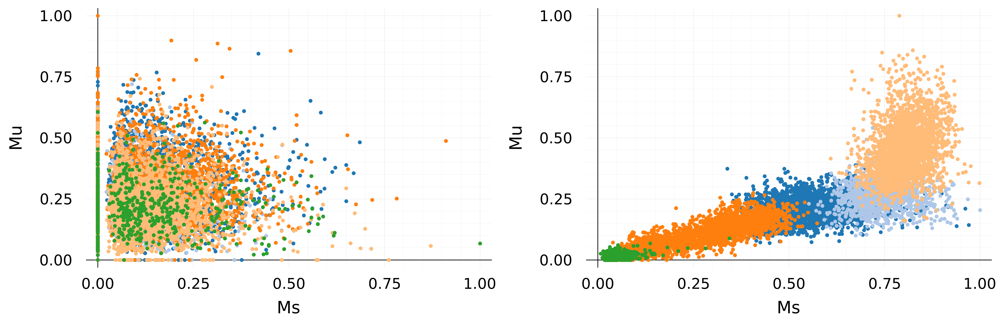

In [10]:
p = plot(p1, p2, layout = (1, 2), size = (1400, 450), bottom_margin = 1.0Plots.cm, left_margin = 1.0Plots.cm, xtickfontsize = 14, ytickfontsize = 14, xguidefontsize = 16, yguidefontsize = 16, dpi = 300)

In [11]:
savefig(p, "figure/Kinetics_comparison.png")

"/media/data/bmi111/KuanChiun/temp/MultiVelo/thesis/method_material/figure/Kinetics_comparison.png"

# Circle kinetics

In [12]:
idx3 = findfirst(x -> x == "Gria2", e18_genes)

580

In [13]:
p3 = scatter(xlabel = "Ms", ylabel = "Mu")
for label in e18_labels
    scatter!(e18_s[idx3, e18_celltype .== label], e18_u[idx3, e18_celltype .== label], markersize = 3, label = nothing)
end

# Complete induction kinetics

In [14]:
idx4 = findfirst(x -> x == "Tgfb2", e18_genes)

37

In [15]:
p4 = scatter(xlabel = "Ms", ylabel = "Mu")
for label in e18_labels
    scatter!(e18_s[idx4, e18_celltype .== label], e18_u[idx4, e18_celltype .== label], markersize = 3, label = nothing)
end

# Complete repression kinetics

In [16]:
idx5 = findfirst(x -> x == "Fn1", ery_genes)

17

In [17]:
p5 = scatter(xlabel = "Ms", ylabel = "Mu")
for label in ery_labels
    scatter!(ery_s[idx5, ery_celltype .== label], ery_u[idx5, ery_celltype .== label], markersize = 3, label = nothing)
end

# Plot figure

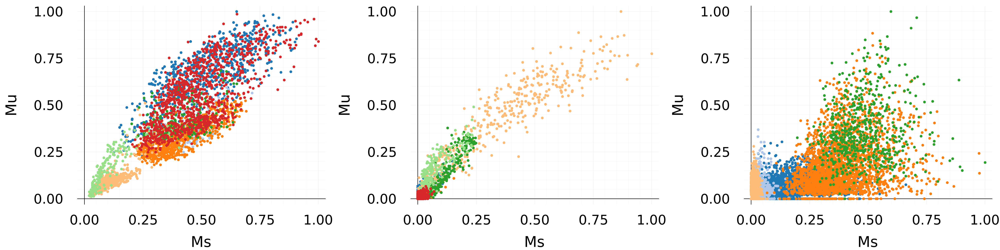

In [18]:
p = plot(p3, p4, p5, layout = (1, 3), size = (2000, 500), bottom_margin = 1.4Plots.cm, left_margin = 1.4Plots.cm, right_margin = 0.2Plots.cm, xtickfontsize = 18, ytickfontsize = 18, xguidefontsize = 20, yguidefontsize = 20, dpi = 300)

In [19]:
savefig(p, "figure/Different_kinetics.png")

"/media/data/bmi111/KuanChiun/temp/MultiVelo/thesis/method_material/figure/Different_kinetics.png"

# Before sampling

In [20]:
idx6 = findfirst(x -> x == "Col19a1", den_genes)

6

In [21]:
p6 = scatter(xlabel = "Ms", ylabel = "Mu", xtickfont = font(10), ytickfont = font(10), xguidefontsize = 14, yguidefontsize = 14, size = (700, 450), margins = 0.6Plots.cm, dpi = 300)
for label in den_labels
    scatter!(den_s[idx6, den_celltype .== label], den_u[idx6, den_celltype .== label], markersize = 3, label = nothing)
end

# After sampling

In [22]:
idx6 = findfirst(x -> x == "Col19a1", den_genes)

6

In [23]:
X = vcat(den_u[idx6, :]', den_s[idx6, :]')

2×18213 Matrix{Float32}:
 0.183544   0.102036  0.00605426  0.0  0.0  0.0  …  0.0  0.0717586  0.0218652
 0.0929194  0.122077  0.0170199   0.0  0.0  0.0     0.0  0.153354   0.0

In [24]:
idx = JuloVelo.density_sampling!(X, 18213; sample_number = 2400);

In [25]:
sample_den_u = den_u[:, idx]
sample_den_s = den_s[:, idx];
sample_den_celltype = den_celltype[idx];

In [26]:
p7 = scatter(xlabel = "Ms", ylabel = "Mu", xtickfont = font(10), ytickfont = font(10), xguidefontsize = 14, yguidefontsize = 14, size = (700, 450), margins = 0.6Plots.cm, dpi = 300)
for label in den_labels
    scatter!(sample_den_s[idx6, sample_den_celltype .== label], sample_den_u[idx6, sample_den_celltype .== label], markersize = 3, label = nothing)
end

# Plot figure 

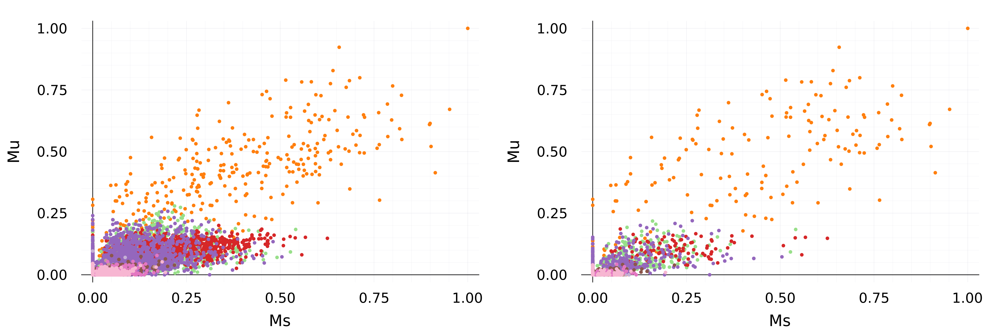

In [27]:
p = plot(p6, p7, layout = (1, 2), size = (1500, 500), bottom_margin = 1.0Plots.cm, left_margin = 1.0Plots.cm, xtickfontsize = 14, ytickfontsize = 14, xguidefontsize = 16, yguidefontsize = 16, dpi = 300)

In [28]:
savefig(p, "figure/Sampling_example.png")

"/media/data/bmi111/KuanChiun/temp/MultiVelo/thesis/method_material/figure/Sampling_example.png"